# Logistic model fit to oak data with sproc

HYBRID-DATA: https://docs.google.com/spreadsheets/d/13tOQniYpGp0Zhy-fvAiG-SRBLrSnSnK5DNfWhPztEzk/edit?usp=sharing

In [1]:
import itertools
import pandas as pd
import numpy as np
import toytree
import toyplot
import arviz as az
import pymc3 as pm

In [2]:
toyplot.config.autoformat = "png"

### Load tree and assign tips to clades

In [4]:
# exclude samples for reason xyz...
EXCLUDE = [
    'Quercus|Quercus|Leucomexicana|Q.species', 
    'Quercus|Quercus|Roburoids|Q.vulcanica',
    'Quercus|Quercus|Roburoids|Q.imeretina', 
    'Quercus|Lobatae|Erythromexicana|Q.lowilliamsii', 
    'Quercus|Lobatae|Agrifoliae|Q.oxyadenia',
    'Quercus|Quercus|Dumosae|Q.pacifica',
    'Quercus|Quercus|Roburoids|Q.kotschyana',
    'Quercus|Quercus|Roburoids|Q.cedrorum', 
    'Quercus|Lobatae|Agrifoliae|Q.tamalpaiensis',
    'Cerris|Cyclobalanopsis|Semiserrata|Q.litoralis', 
    'Cerris|Cyclobalanopsis|Semiserrata|Q.patelliformis',
    'Cerris|Cyclobalanopsis|Glauca|Q.multinervis', 
    'Cerris|Ilex|Himalayansubalpine|Q.sp.nov.',
]

In [5]:
TREE = toytree.tree("/home/henry/oaks-thesis/full_crown2.tre").drop_tips(EXCLUDE)

# find duplicates (label ends in 1 or 2, we'll drop the 2)
DUPS = [i for i in TREE.get_tip_labels() if i.endswith('2')]
TREE = TREE.drop_tips(DUPS)

# relabel kept duplicate tips by stripping 1 from end
TREE = TREE.set_node_values(
    feature="name", 
    values={nidx: TREE.idx_dict[nidx].name.strip("1") for nidx in TREE.idx_dict}
)

# Scale tree to 1.0 length
TREE = TREE.mod.node_scale_root_height(1.0)

In [7]:
# Get crown nodes for eight clades.
clades = [
    "Quercus|Quercus", # teal
    "Quercus|Virentes", # orange
    "Quercus|Ponticae", # blue
    "Quercus|Protobalanus", # pink
    "Quercus|Lobatae", # green
    "Cerris|Ilex", # yellow
    "Cerris|Cerris", # tan
    "Cerris|Cyclobalanopsis", # gray
]
crowns = {
    TREE.get_mrca_idx_from_tip_labels(wildcard=i): i for i in clades
}
crowns

{419: 'Quercus|Quercus',
 420: 'Quercus|Virentes',
 434: 'Quercus|Ponticae',
 447: 'Quercus|Protobalanus',
 455: 'Quercus|Lobatae',
 450: 'Cerris|Ilex',
 451: 'Cerris|Cerris',
 457: 'Cerris|Cyclobalanopsis'}

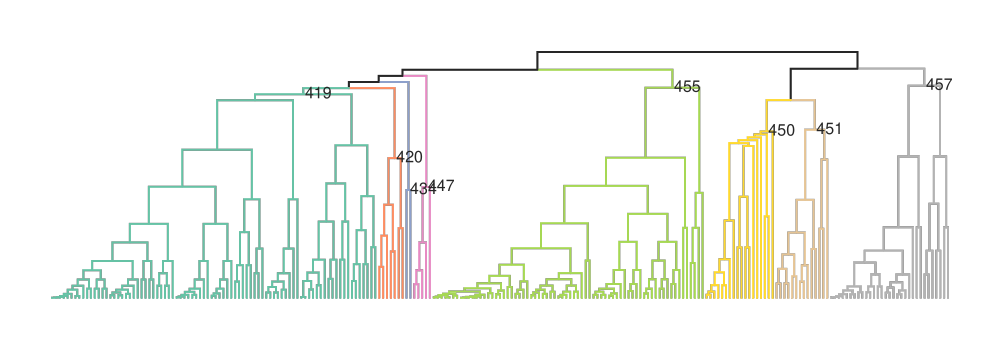

In [8]:
# draw the tree
TREE.draw(
    layout='d', 
    edge_colors=TREE.get_edge_values_mapped({
            j: toytree.colors[i] for i,j in enumerate(crowns)
        }),
    tip_labels=False,
    height=350,
    node_labels=[
        str(i) if int(i) in crowns else "" 
        for i in TREE.get_node_values("idx", 1, 1)
    ],
    node_labels_style={
        "font-size": "16px",
        "-toyplot-anchor-shift": "15px",
    },
);

### Load hybrid crossing data

In [17]:
# load datasets
data = pd.read_csv('/home/henry/oaks-thesis/csv-files/oak-hybrid-5.6.21.csv')
data = data.loc[data.exclude != 1, :]
data

,speciesA,speciesB,author,datatype,hybrid,exclude,notes,overlap,records
0,alba,bicolor,Trelease 1917,morphology,1,NaN,NaN,NaN,NaN
1,alba,macrocarpa,Trelease 1917,morphology,1,NaN,NaN,NaN,NaN
2,alba,montana,Trelease 1917,morphology,1,NaN,NaN,NaN,NaN
3,alba,muehlenbergii,Trelease 1917,morphology,1,NaN,NaN,NaN,NaN
4,alba,prinoides,Trelease 1917,morphology,1,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
2105,conzattii,vaseyana,sproc,sproc,0,NaN,NaN,NaN,NaN
2106,conzattii,pungens,sproc,sproc,0,NaN,NaN,NaN,NaN
2107,conzattii,laceyi,sproc,sproc,0,NaN,NaN,NaN,NaN
2108,conzattii,polymorpha,sproc,sproc,0,NaN,NaN,NaN,NaN


In [18]:
# record RI as inverse of hybrid
data["RI"] = abs(data.hybrid - 1)

# subsample to relevant columns
data = data.loc[:, ["speciesA", "speciesB", "RI"]]

In [19]:
# order names alphabetically
for idx in data.index:
    if data.speciesA[idx] > data.speciesB[idx]:
        _a = data.loc[idx, 'speciesA']
        _b = data.loc[idx, 'speciesB']
        data.loc[idx, 'speciesA'] = _b
        data.loc[idx, 'speciesB'] = _a

In [20]:
# remove any duplicated records
data = data.drop_duplicates(subset=['speciesA', 'speciesB'])

In [21]:
# translate tip names in data to idx in TREE (sidx)
transform = {
    TREE.idx_dict[nidx].name.split("|")[-1][2:]: nidx 
    for nidx in TREE.idx_dict 
    if TREE.idx_dict[nidx].is_leaf()
}
data['sidx0'] = [transform.get(i, pd.NA) for i in data.speciesA.tolist()]
data['sidx1'] = [transform.get(i, pd.NA) for i in data.speciesB.tolist()]

In [22]:
data.head()

,speciesA,speciesB,RI,sidx0,sidx1
0,alba,bicolor,0,52,47
1,alba,macrocarpa,0,52,49
2,alba,montana,0,52,54
3,alba,muehlenbergii,0,52,50
4,alba,prinoides,0,52,51


In [24]:
# find any rows that have NA (species not in TREE)
missing = set(data.speciesA[data.sidx0.isna()].unique())
missing.update(set(data.speciesB[data.sidx1.isna()].unique()))
missing

{'cornelius‐mulleri'}

In [25]:
# drop any rows containing an NA value
data = data.loc[data.sidx0.notna() & data.sidx1.notna(), :].reset_index(drop=True)
data.sidx0 = data.sidx0.astype(int)
data.sidx1 = data.sidx1.astype(int)

In [26]:
# get 1-scaled genetic distances between pairs
def get_dist(tree, idx0, idx1):
    "returns the genetic distance between two nodes on a tree"
    dist = tree.treenode.get_distance(
        tree.idx_dict[idx0], 
        tree.idx_dict[idx1],
    )
    return dist

data['dist'] = [get_dist(TREE, i, j) / 2 for (i, j) in zip(data.sidx0, data.sidx1)]

In [27]:
# add RI=0 for all within-species comparisons
idx = data.shape[0]
for nidx in range(TREE.ntips):
    node = TREE.idx_dict[nidx]
    name = node.name.split("|")[-1][2:]
    data.loc[idx] = name, name, 0, nidx, nidx, 0.0
    idx += 1

In [28]:
data

,speciesA,speciesB,RI,sidx0,sidx1,dist
0,alba,bicolor,0,52,47,0.401786
1,alba,macrocarpa,0,52,49,0.401786
2,alba,montana,0,52,54,0.200893
3,alba,muehlenbergii,0,52,50,0.401786
4,alba,prinoides,0,52,51,0.401786
...,...,...,...,...,...,...
2264,rex,rex,0,226,226,0.000000
2265,chungii,chungii,0,227,227,0.000000
2266,delavayi,delavayi,0,228,228,0.000000
2267,championii,championii,0,229,229,0.000000


In [34]:
# add normalized dist
data['normdist'] = ((data['dist'] - data['dist'].mean()) / data['dist'].std())

In [38]:
# make group index (gidx)
crown_dict = {i: TREE.get_tip_labels(i) for i in crowns}
gidx = np.zeros(TREE.ntips, dtype=int)
for tidx, tip in enumerate(TREE.get_tip_labels()):
    for cidx, clade in enumerate(crown_dict):
        if tip in crown_dict[clade]:
            gidx[tidx] = cidx
gidx

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1,
       1, 1, 1, 2, 2, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 5, 5, 5, 5, 5, 5, 5, 5,
       5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6,
       6, 6, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7,
       7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7])

### VISUALIZE THE HYBRID CROSSING DATA

In [39]:
def heatmap_plot(TREE, CLADES, data, **kwargs):
    """
    Sanity check: does the data make sense?
    """
    # get canvas size
    canvas = toyplot.Canvas(
        width=kwargs.get('width', 600),
        height=kwargs.get('height', 600),
    );

    # add tree to canvas
    ax0 = canvas.cartesian(
        bounds=("5%", "25%", "5%", "95%"),
        show=False
    )
    TREE.draw(
        axes=ax0, 
        layout='r', 
        tip_labels=False,
        edge_colors=TREE.get_edge_values_mapped({
            j: toytree.colors[i] for i,j in enumerate(CLADES)
        })
    )
    NSPECIES = TREE.ntips

    # add heatmap to canvas
    ax1 = canvas.table(
        rows=NSPECIES, 
        columns=NSPECIES, 
        bounds=("27%", "95%", "5%", "95%"),
        margin=20
    )
    ax1.cells.cell[:].style = {
        "fill": 'lightgrey',
        "stroke": "none"
    }

    # set values for data
    for idx in data.index:
        ridx, cidx = data.loc[idx, ['sidx0', 'sidx1']]
        rridx = NSPECIES - ridx - 1
        ccidx = NSPECIES - cidx - 1
        ridx, cidx, rridx, ccidx = [
            int(i) for i in (ridx, cidx, rridx, ccidx)
        ]

        # get RI for this cell
        value = data.loc[idx, 'RI']
        if value:
            color = "red"
        else:
            color = "black"
        
        ax1.cells.cell[rridx, cidx].style = {
            "fill": color,
            "stroke": "none"
        }
        ax1.cells.cell[ccidx, ridx].style = {
            "fill": color,
            "stroke": "none"
        }

    # dividers
    ax1.body.gaps.columns[...] = 0.
    ax1.body.gaps.rows[...] = 0.
    
    return canvas

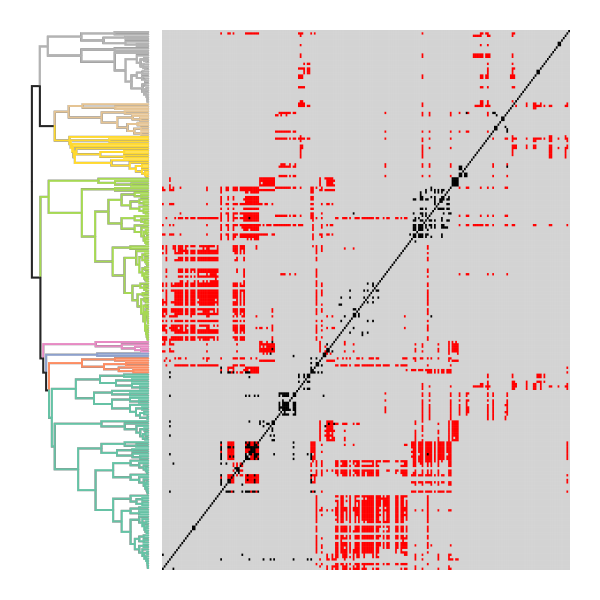

In [40]:
heatmap_plot(TREE, crown_dict, data)

In [41]:
def dist_RI_scatterplot(TREE, data, jitter=0.01):
    """
    Scatterplot of RI values x genetic dist with the 
    genetic distance values jittered slightly to show
    more clearly despite overlap.
    """
    canvas = toyplot.Canvas(width=300, height=300)
    axes = canvas.cartesian(
        xlabel="Genetic dist.",
        ylabel="Reproductive isolation",
    )
    ns = sum(data.RI == 0)
    xs = data.dist[data.RI == 0] + np.random.uniform(-jitter, jitter, size=ns)
    xs[xs > 1] = 1
    xs[xs < 0] = 0    
    mark = axes.scatterplot(
        xs,
        data.RI[data.RI == 0],
        size=10,
        opacity=0.1,
        marker="|",
        mstyle={
            "stroke": 'black',
            "stroke-width": 3,
        },
    );
    ns = sum(data.RI == 1)
    xs = data.dist[data.RI == 1] + np.random.uniform(-jitter, jitter, size=ns)
    xs[xs > 1] = 1
    xs[xs < 0] = 0
    mark = axes.scatterplot(
        xs,
        data.RI[data.RI == 1],
        size=10,
        opacity=0.1,
        marker="|",
        mstyle={
            "stroke": 'red',
            "stroke-width": 3,
        },
    );
    axes.x.ticks.show = True
    axes.y.ticks.show = True
    return canvas, axes, mark

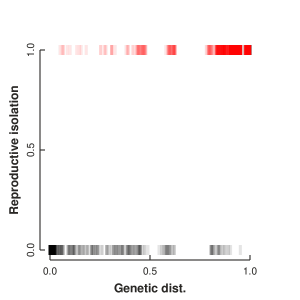

In [42]:
dist_RI_scatterplot(TREE, data, jitter=0.025);

In [43]:
data[data.RI == 0].sort_values(by='dist', ascending=False).head(10)

,speciesA,speciesB,RI,sidx0,sidx1,dist,normdist
71,laurifolia,macrocarpa,0,150,49,0.927411,0.495729
140,cedrosensis,engelmannii,0,97,62,0.902643,0.420078
141,engelmannii,tomentella,0,62,94,0.902643,0.420078
194,pontica,robur,0,91,74,0.877875,0.344427
193,garryana,sadleriana,0,61,92,0.877875,0.344427
110,minima,stellata,0,86,33,0.853107,0.268776
107,margarettae,virginiana,0,37,84,0.853107,0.268776
89,stellata,virginiana,0,33,84,0.853107,0.268776
177,turbinella,virginiana,0,4,84,0.853107,0.268776
106,austrina,virginiana,0,38,84,0.853107,0.268776


### Fit models

In [44]:
def toytrace(trace, var_names, titles):
    """
    Plot posterior trace with toyplot
    """
    nvars = len(var_names)
    
    # setup canvase
    canvas = toyplot.Canvas(width=500, height=200 * nvars)
    
    # store axes
    axes = []
    
    # iter over params
    for pidx, param in enumerate(var_names):
        
        # get param posterior
        posterior = trace.get_values(param)
        
        # setup axes 
        ax = canvas.cartesian(grid=(nvars, 1, pidx))
        ax.y.show = False
        ax.x.spine.style = {"stroke-width": 1.5}
        ax.x.ticks.labels.style = {"font-size": "12px"}
        ax.x.ticks.show = True
        ax.x.label.text = f"param='{titles[pidx]}'"        
        
        # iterate over shape of param
        for idx in range(posterior.shape[1]):
            mags, bins = np.histogram(posterior[:, idx], bins=100)
            ax.plot(bins[1:], mags, stroke_width=2, opacity=0.6)
        axes.append(ax)
    return canvas, axes

In [45]:
def partpooled_linear(x, y, idx0, idx1, gidx, **kwargs):
    
    # define model
    with pm.Model() as model:
        
        # indexers
        sidx0 = pm.Data("spp_idx0", idx0)
        sidx1 = pm.Data("spp_idx1", idx1)
        gidx = pm.Data("gidx", gidx)

        # parameters and error
        𝜓_mean = pm.Normal('𝜓_mean', mu=0., sigma=5., shape=len(crowns))
        𝜓_std = pm.HalfNormal('𝜓_std', 5., shape=len(crowns))
        𝜓_offset = pm.Normal('𝜓_offset', mu=0, sigma=1., shape=TREE.ntips)
        𝜓 = pm.Deterministic('𝜓', 𝜓_mean[gidx] + 𝜓_std[gidx] * 𝜓_offset)
        𝛽 = pm.Normal('𝛽', mu=0., sigma=10., shape=1)
        𝛼 = pm.Normal('𝛼', mu=0., sigma=10., shape=1)
        
        # linear model prediction
        effect = 𝛼 + (𝛽 + 𝜓[sidx0] + 𝜓[sidx1]) * x
        logit = pm.Deterministic("logit", pm.invlogit(effect))
        
        # data likelihood (normal distributed errors)
        y_like = pm.Bernoulli("y", p=logit, observed=y)
        
        # sample posterior, skip burnin
        trace = pm.sample(**kwargs)[1000:]

        # show summary table
        stats = pm.summary(trace)
        
    # organize results
    result_dict = {
        'model': model, 
        'trace': trace,
        'stats': stats,
    }
    return result_dict

In [88]:
def partpooled_logarithmic(x, y, idx0, idx1, gidx, **kwargs):
    
    # define model
    with pm.Model() as model:
        
        # indexers
        sidx0 = pm.Data("spp_idx0", idx0)
        sidx1 = pm.Data("spp_idx1", idx1)
        gidx = pm.Data("gidx", gidx)

        # parameters and error
        𝜓_mean = pm.Normal('𝜓_mean', mu=0., sigma=5., shape=len(crowns))
        𝜓_std = pm.HalfNormal('𝜓_std', 5., shape=len(crowns))
        𝜓_offset = pm.Normal('𝜓_offset', mu=0, sigma=1., shape=TREE.ntips)
        𝜓 = pm.Deterministic('𝜓', 𝜓_mean[gidx] + 𝜓_std[gidx] * 𝜓_offset)
        𝛽 = pm.Normal('𝛽', mu=0., sigma=10., shape=1)
        𝛼 = pm.Normal('𝛼', mu=0., sigma=10., shape=1)
        
        # linear model prediction
        effect = 𝛼 + (𝛽 + 𝜓[sidx0] + 𝜓[sidx1]) * np.log(1 + x)
        logit = pm.Deterministic("logit", pm.invlogit(effect))
        
        # data likelihood (normal distributed errors)
        y_like = pm.Bernoulli("y", p=logit, observed=y)
        
        # sample posterior, skip burnin
        trace = pm.sample(**kwargs)[1000:]

        # show summary table
        stats = pm.summary(trace)
        
    # organize results
    result_dict = {
        'model': model, 
        'trace': trace,
        'stats': stats,
    }
    return result_dict

In [76]:
def partpooled_exponential(x, y, idx0, idx1, gidx, **kwargs):
    
    # define model
    with pm.Model() as model:
        
        # indexers
        sidx0 = pm.Data("spp_idx0", idx0)
        sidx1 = pm.Data("spp_idx1", idx1)
        gidx = pm.Data("gidx", gidx)

        # parameters and error
        𝜓_mean = pm.Normal('𝜓_mean', mu=0., sigma=5., shape=len(crowns))
        𝜓_std = pm.HalfNormal('𝜓_std', 5., shape=len(crowns))
        𝜓_offset = pm.Normal('𝜓_offset', mu=0, sigma=1., shape=TREE.ntips)
        𝜓 = pm.Deterministic('𝜓', 𝜓_mean[gidx] + 𝜓_std[gidx] * 𝜓_offset)
        𝛽 = pm.Normal('𝛽', mu=0.5, sigma=10., shape=1)
        𝛼 = pm.Normal('𝛼', mu=0., sigma=10., shape=1)
        
        # linear model prediction
        effect = 𝛼 * ((𝛽 + 𝜓[sidx0] + 𝜓[sidx1]) ** x)
        logit = pm.Deterministic("logit", pm.invlogit(effect))
        
        # data likelihood (normal distributed errors)
        y_like = pm.Bernoulli("y", p=logit, observed=y)
        
        # sample posterior, skip burnin
        trace = pm.sample(init = 'adapt_diag', **kwargs)[1000:]

        # show summary table
        stats = pm.summary(trace)
        
    # organize results
    result_dict = {
        'model': model, 
        'trace': trace,
        'stats': stats,
    }
    return result_dict

In [48]:
def partpooled_asymptotic(x, y, idx0, idx1, gidx, **kwargs):
    
    # define model
    with pm.Model() as model:
        
        # indexers
        sidx0 = pm.Data("spp_idx0", idx0)
        sidx1 = pm.Data("spp_idx1", idx1)
        gidx = pm.Data("gidx", gidx)

        # parameters and error
        𝜓_mean = pm.Normal('𝜓_mean', mu=0., sigma=5., shape=len(crowns))
        𝜓_std = pm.HalfNormal('𝜓_std', 5., shape=len(crowns))
        𝜓_offset = pm.Normal('𝜓_offset', mu=0, sigma=1., shape=TREE.ntips)
        𝜓 = pm.Deterministic('𝜓', 𝜓_mean[gidx] + 𝜓_std[gidx] * 𝜓_offset)
        𝛽 = pm.Normal('𝛽', mu=0., sigma=10., shape=1)
        𝛼 = pm.Normal('𝛼', mu=0., sigma=10., shape=1)
        
        # linear model prediction
        effect = 1 - (1 -𝛼) * np.exp(-(𝛽 + 𝜓[sidx0] + 𝜓[sidx1]) * x)
        logit = pm.Deterministic("logit", pm.invlogit(effect))
        
        # data likelihood (normal distributed errors)
        y_like = pm.Bernoulli("y", p=logit, observed=y)
        
        # sample posterior, skip burnin
        trace = pm.sample(**kwargs)[1000:]

        # show summary table
        stats = pm.summary(trace)
        
    # organize results
    result_dict = {
        'model': model, 
        'trace': trace,
        'stats': stats,
    }
    return result_dict

In [49]:
def partpooled_quadratic(x, y, idx0, idx1, gidx, **kwargs):
    
    # define model
    with pm.Model() as model:
        
        # indexers
        sidx0 = pm.Data("spp_idx0", idx0)
        sidx1 = pm.Data("spp_idx1", idx1)
        gidx = pm.Data("gidx", gidx)

        # parameters and error
        𝜓_mean = pm.Normal('𝜓_mean', mu=0., sigma=5., shape=len(crowns))
        𝜓_std = pm.HalfNormal('𝜓_std', 5., shape=len(crowns))
        𝜓_offset = pm.Normal('𝜓_offset', mu=0, sigma=1., shape=TREE.ntips)
        𝜓 = pm.Deterministic('𝜓', 𝜓_mean[gidx] + 𝜓_std[gidx] * 𝜓_offset)
        𝛽 = pm.Normal('𝛽', mu=0., sigma=10., shape=1)
        𝛼 = pm.Normal('𝛼', mu=0., sigma=10., shape=1)
        
        # linear model prediction
        effect = ((𝛽 + 𝜓[sidx0] + 𝜓[sidx1]) * x ** 2) + 𝛼 * x
        logit = pm.Deterministic("logit", pm.invlogit(effect))
        
        # data likelihood (normal distributed errors)
        y_like = pm.Bernoulli("y", p=logit, observed=y)
        
        # sample posterior, skip burnin
        trace = pm.sample(**kwargs)[1000:]

        # show summary table
        stats = pm.summary(trace)
        
    # organize results
    result_dict = {
        'model': model, 
        'trace': trace,
        'stats': stats,
    }
    return result_dict

In [50]:
# MCMC sampler kwargs
sample_kwargs = dict(
    tune=10000,
    draws=10000,
    target_accept=0.99,
    return_inferencedata=False,
    progressbar=True,
)

In [51]:
# model input
model_args = [
    data.dist,
    data.RI,
    data.sidx0,
    data.sidx1,
    gidx,
]

In [52]:
linear = partpooled_linear(*model_args, **sample_kwargs)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [𝛼, 𝛽, 𝜓_offset, 𝜓_std, 𝜓_mean]


Sampling 4 chains for 10_000 tune and 10_000 draw iterations (40_000 + 40_000 draws total) took 6912 seconds.


In [89]:
logarithmic = partpooled_logarithmic(*model_args, **sample_kwargs)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [𝛼, 𝛽, 𝜓_offset, 𝜓_std, 𝜓_mean]


Sampling 4 chains for 10_000 tune and 10_000 draw iterations (40_000 + 40_000 draws total) took 2624 seconds.
The number of effective samples is smaller than 25% for some parameters.


In [77]:
exponential = partpooled_exponential(*model_args, **sample_kwargs)

Auto-assigning NUTS sampler...
Initializing NUTS using adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [𝛼, 𝛽, 𝜓_offset, 𝜓_std, 𝜓_mean]


Sampling 4 chains for 10_000 tune and 10_000 draw iterations (40_000 + 40_000 draws total) took 3902 seconds.
There were 9944 divergences after tuning. Increase `target_accept` or reparameterize.
There were 9965 divergences after tuning. Increase `target_accept` or reparameterize.
There were 9995 divergences after tuning. Increase `target_accept` or reparameterize.
There were 9957 divergences after tuning. Increase `target_accept` or reparameterize.
The rhat statistic is larger than 1.2 for some parameters.
The estimated number of effective samples is smaller than 200 for some parameters.


In [73]:
for RV in exponential['model'].basic_RVs:
    print(RV.name, RV.logp(exponential['model'].test_point))

𝜓_mean -20.227011565110185
𝜓_std_log__ -6.159140731785961
𝜓_offset -212.27480117027983
𝛽 -3.2215236261987186
𝛼 -3.2215236261987186
y -1572.750952690433


In [83]:
asymptotic = partpooled_asymptotic(*model_args, **sample_kwargs)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [𝛼, 𝛽, 𝜓_offset, 𝜓_std, 𝜓_mean]


IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

IOPub message rate exceed

In [82]:
quadratic = partpooled_quadratic(*model_args, **sample_kwargs)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [𝛼, 𝛽, 𝜓_offset, 𝜓_std, 𝜓_mean]


Sampling 4 chains for 10_000 tune and 10_000 draw iterations (40_000 + 40_000 draws total) took 5679 seconds.
There were 87 divergences after tuning. Increase `target_accept` or reparameterize.
There were 95 divergences after tuning. Increase `target_accept` or reparameterize.
There were 82 divergences after tuning. Increase `target_accept` or reparameterize.
There were 88 divergences after tuning. Increase `target_accept` or reparameterize.


In [90]:
az_linear = az.from_pymc3(trace = linear['trace'], model = linear['model'])
az_logarithmic = az.from_pymc3(trace = logarithmic['trace'], model = logarithmic['model'])
az_exponential = az.from_pymc3(trace = exponential['trace'], model = exponential['model'])
az_asymptotic = az.from_pymc3(trace = asymptotic['trace'], model = asymptotic['model'])
az_quadratic = az.from_pymc3(trace = quadratic['trace'], model = quadratic['model'])

In [91]:
az.compare({"linear": az_linear,
            "logarithmic": az_logarithmic, 
            "exponential": az_exponential,
           "asymptotic": az_asymptotic,
           "quadratic": az_quadratic})

/home/henry/miniconda3/envs/py37/lib/python3.7/site-packages/arviz/stats/stats.py:150: UserWarning: 
The scale is now log by default. Use 'scale' argument or 'stats.ic_scale' rcParam if you rely on a specific value.
A higher log-score (or a lower deviance) indicates a model with better predictive accuracy.
  "\nThe scale is now log by default. Use 'scale' argument or "
/home/henry/miniconda3/envs/py37/lib/python3.7/site-packages/arviz/stats/stats.py:684: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  "Estimated shape parameter of Pareto distribution is greater than 0.7 for "
/home/henry/miniconda3/envs/py37/lib/python3.7/site-packages/arviz/stats/stats.py:684: Use

,rank,loo,p_loo,d_loo,weight,se,dse,warning,loo_scale
linear,0,-195.237,38.6308,0,0.990078,19.2853,0,True,log
logarithmic,1,-201.339,38.2688,6.10122,0.00992218,19.542,1.68799,True,log
quadratic,2,-345.223,41.6329,149.985,1.98313e-47,17.7094,16.1088,True,log
exponential,3,-449.185,7.44378,253.948,4.98263e-86,22.7003,18.9814,False,log
asymptotic,4,-769.288,201.839,574.051,2.11446e-223,19.0126,18.5863,True,log


### Examine linear model results

In [106]:
linear['stats'].head(10)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
𝜓_mean[0],-0.050,1.877,-3.537,3.481,0.014,0.010,18894.0,18894.0,18886.0,24726.0,1.0
𝜓_mean[1],-0.345,2.300,-4.622,4.028,0.015,0.011,24243.0,23863.0,24208.0,26967.0,1.0
𝜓_mean[2],-3.178,2.923,-8.711,2.407,0.016,0.012,33250.0,29029.0,33527.0,29985.0,1.0
𝜓_mean[3],0.811,2.334,-3.488,5.254,0.015,0.010,25710.0,25702.0,25489.0,28458.0,1.0
𝜓_mean[4],1.068,1.841,-2.434,4.511,0.013,0.009,19263.0,19263.0,19259.0,24212.0,1.0
𝜓_mean[5],2.423,2.726,-2.461,7.744,0.015,0.011,31061.0,28711.0,30822.0,29528.0,1.0
𝜓_mean[6],0.131,2.247,-3.962,4.519,0.015,0.010,23832.0,23832.0,23788.0,26321.0,1.0
𝜓_mean[7],5.161,3.346,-0.969,11.435,0.017,0.013,39795.0,30765.0,41656.0,27813.0,1.0
𝜓_offset[0],0.236,0.853,-1.325,1.833,0.003,0.005,68287.0,16668.0,74102.0,24437.0,1.0
𝜓_offset[1],0.231,0.876,-1.321,1.932,0.003,0.005,71654.0,14334.0,78991.0,24985.0,1.0


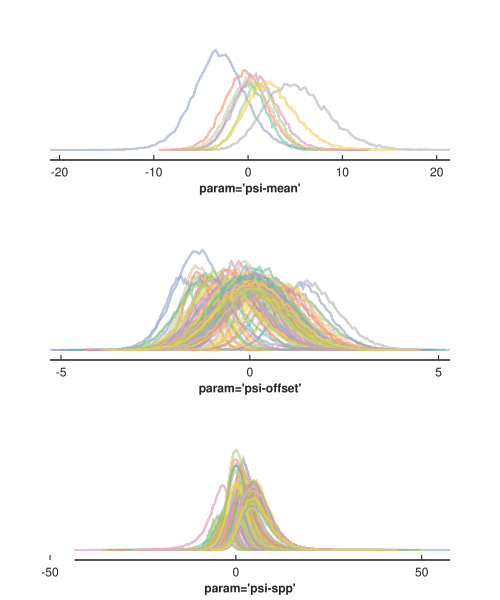

In [92]:
toytrace(linear['trace'], ['𝜓_mean', '𝜓_offset', '𝜓'], ['psi-mean', 'psi-offset', 'psi-spp']);

In [94]:
import scipy.stats as stats

def draw_velocity_dists(trace, baseline=0.15):
    """
    Draw the clade velocities as gaussians
    """
    canvas = toyplot.Canvas(width=350, height=300)
    axes = canvas.cartesian(xlabel="Relative velocity of reproductive isolation")
    marks = []
    base = 0
    for i in range(trace['𝜓_mean'].shape[1]):
        
        loc = trace['𝜓_mean'][:, i].mean()
        scale = trace['𝜓_std'][:, i].mean()
        interval = stats.norm.interval(0.995, loc, scale)
        points = np.linspace(interval[0], interval[1], 100)
        mark = axes.fill(
            points, 
            stats.norm.pdf(points, loc=loc, scale=scale), 
            style={
                "fill-opacity": 0.45,
                "stroke": 'black',
                "stroke-opacity": 1.0,
                "stroke-width": 1,
            },
            baseline=np.repeat(base, 100),
        )
        marks.append(mark)
        axes.hlines(base, style={"stroke-dasharray": "5,5", 'stroke-width': 1})
        base += baseline
        
    axes.y.show = False
    axes.x.ticks.locator = toyplot.locator.Extended(only_inside=True)
    axes.x.ticks.show = True
    return canvas, axes, marks

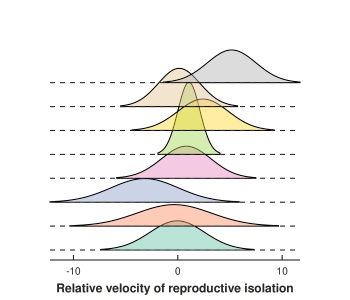

In [95]:
draw_velocity_dists(linear['trace'], baseline=0.125);

### RESULT FIGURES

In [96]:
linear['trace'].varnames

['𝜓_mean', '𝜓_std_log__', '𝜓_offset', '𝛽', '𝛼', '𝜓_std', '𝜓', 'logit']

In [97]:
a, b = zip(*itertools.combinations(range(TREE.ntips), 2))
post = pd.DataFrame({
    "sidx0": a,
    "sidx1": b,
    "dist": [get_dist(TREE, i, j) / 2. for (i, j) in zip(a, b)],
})
psi_means = linear['trace']['𝜓'].mean(axis=0)
post["RI"] = (
    linear['trace']['𝛼'].mean() + [
        linear['trace']['𝛽'].mean() + psi_means[i] + psi_means[j] 
        for (i, j) in zip(a, b)
    ] * post['dist']
)
post["RI"] = 1 / (1 + np.exp(-(post["RI"])))
post.head()

,sidx0,sidx1,dist,RI
0,0,1,0.001046,0.004559
1,0,2,0.002093,0.004625
2,0,3,0.004185,0.004744
3,0,4,0.008371,0.004854
4,0,5,0.016741,0.005622


In [98]:
def dist_RI_results_scatterplot(data, jitter=0.01):
    """
    Scatterplot of RI values x genetic dist with the 
    genetic distance values jittered slightly to show
    more clearly despite overlap.
    """
    canvas = toyplot.Canvas(width=300, height=300)
    axes = canvas.cartesian(
        label="logit sigmoid function fit to data",
        xlabel="Genetic distance",
        ylabel="Probability of RI",
    )
    mark = axes.scatterplot(
        data.dist + np.random.uniform(-jitter, jitter, size=data.dist.size),
        data.RI,
        size=8,
        opacity=0.1,
        mstyle={
            "stroke": "none",
            "fill": '#262626',
            "fill-opacity": 0.33,
        },
    );
    axes.x.ticks.show = True
    axes.y.ticks.show = True
    return canvas, axes, mark

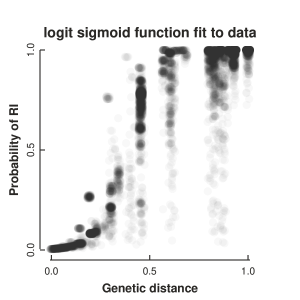

In [99]:
dist_RI_results_scatterplot(post);

In [100]:
def heat_results_plot(TREE, CLADES, results):
    
    # get canvas size
    canvas = toyplot.Canvas(width=500, height=500);

    # colormap for values between 0-1
    cmap_lower = toyplot.color.LinearMap(
        domain_min=results.RI.min(), 
        domain_max=results.RI.max()
    )

    # add tree to canvas
    ax0 = canvas.cartesian(
        bounds=("5%", "25%", "5%", "95%"),
        show=False
    )
    TREE.draw(
        axes=ax0, 
        layout='r', 
        tip_labels=False,
        edge_colors=TREE.get_edge_values_mapped({
            j: toytree.colors[i] for i,j in enumerate(CLADES)
        })
    )
    NSPECIES = TREE.ntips

    # add heatmap to canvas
    ax1 = canvas.table(
        rows=NSPECIES, 
        columns=NSPECIES, 
        bounds=("27%", "88%", "5%", "95%"),
        margin=20
    )
    ax1.cells.cell[:].style = {
        "fill": 'lightgrey',
        "stroke": "none"
    }

    # set values for data
    for idx in results.index:
        ridx, cidx = results.loc[idx, ['sidx0', 'sidx1']]
        rridx = NSPECIES - ridx - 1
        ccidx = NSPECIES - cidx - 1
        ridx, cidx, rridx, ccidx = [
            int(i) for i in (ridx, cidx, rridx, ccidx)
        ]

        # get RI for this cell
        value = results.at[idx, 'RI']
        
        # fill below diagonal with logit
        ax1.cells.cell[rridx, cidx].style = {
            "fill": cmap_lower.color(value),
            "stroke": "none"
        }
        
        # randomly sample RI using logit probability for color
        if np.random.binomial(1, results.at[idx, "RI"]):
            fill = "white"
        else:
            fill = "black"

        # fill above diagonal with sampled RI 
        ax1.cells.cell[ccidx, ridx].style = {
            "fill": fill,
            "stroke": "none"
        }

    for idx in range(NSPECIES):
        ax1.cells.cell[NSPECIES - idx - 1, idx].style = {
            "fill": cmap_lower.color(0),
            "stroke": "none"
        }

    # dividers
    ax1.body.gaps.columns[...] = 0.0
    ax1.body.gaps.rows[...] = 0.0
    
    # add a colorbar
    numberline = canvas.numberline("92%", "95%", "92%", "5%")
    numberline.colormap(cmap_lower, style={"stroke-width": 5})

    return canvas

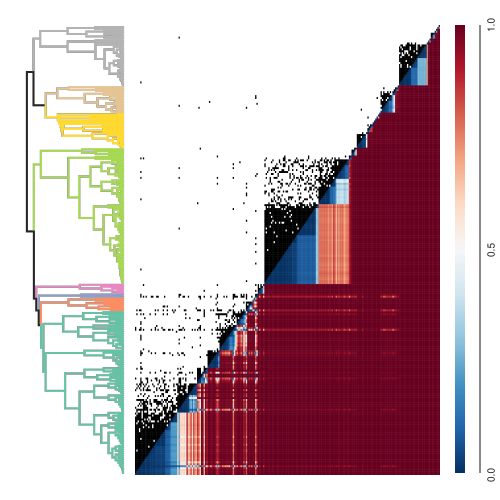

In [101]:
heat_results_plot(TREE, crowns, post)

### Rates on tree
This figure could be made much prettier...

In [103]:
psi_means = linear['trace']['𝜓'].mean(axis=0)

In [104]:
def plot_tree_rates(TREE, CLADES, values,  **kwargs):
    
    # get canvas size
    canvas = toyplot.Canvas(
        width=kwargs.get('width', 500),
        height=kwargs.get('height', 500),
    )
    
    # colormap for values between 0-1
    cmap_lower = toyplot.color.LinearMap(
        domain_min=values.min(), 
        domain_max=values.max()
    )
    
    # add tree to canvas
    ax0 = canvas.cartesian(
        bounds=("10%", "40%", "5%", "85%"),
        show=False
    )
    TREE.draw(
        axes=ax0, 
        layout='r', 
        tip_labels=False,
        edge_colors=TREE.get_edge_values_mapped({
            j: toytree.colors[i] for i,j in enumerate(CLADES)
        })
    )
    NSPECIES = TREE.ntips
    
    ax1 = canvas.cartesian(
        bounds=("45%", "90%", "5%", "85%"),
        yshow=False,
        xlabel="RI velocity",
    )
    ax1.scatterplot(
        values, 
        np.arange(TREE.ntips),
        mstyle={"fill": 'black', 'stroke': 'none'},
    )    
    ax1.x.ticks.show = True
    
    return canvas, (ax0, ax1)

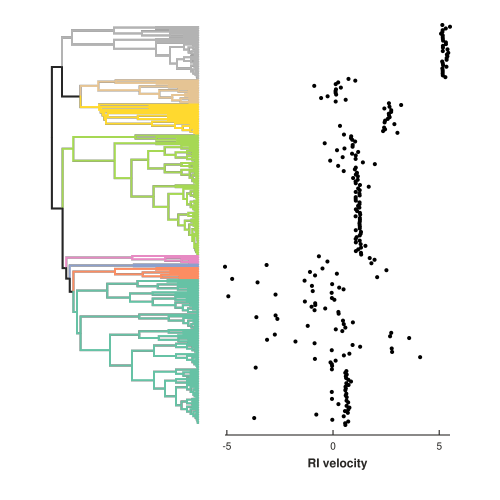

In [105]:
plot_tree_rates(TREE, crowns, psi_means);